# Apr 21st, 2022 (Ca clean, many adj plots, Yale comare RABIES)

**Motivation**: 

<br>

In [1]:
# HIDE CODE


import os
import sys
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from numpy.ma import masked_where as mwh
from IPython.display import display, IFrame, HTML

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
_fig_dir = pjoin(git_dir, 'jb-Ca-fMRI/figs')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = 'Documents/workspaces/lfr/binary_overlapping'
lfr_dir = pjoin(os.environ['HOME'], lfr_dir)

# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# set style & no interpolalation
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

## Fig dir

In [2]:
mako = sns.color_palette('mako', as_cmap=True)
rocket = sns.color_palette('rocket', as_cmap=True)
pal = {'ca2': mako(0.6), 'bold-lite': rocket(0.6)}

fig_kws = {
    'transparent': True,
    'bbox_inches': 'tight',
}
fig_dir = pjoin(_fig_dir, 'quality_control')
os.makedirs(fig_dir, exist_ok=True)
fig_dir

'/home/hadi/Dropbox/git/jb-Ca-fMRI/figs/quality_control'

## Plot avg degree

### 128 * 3 (explore)

In [3]:
mice = Mice((128, 3))
mice.setup_func_data(exclude=False)

In [4]:
adj_all_ca, dirs_ca = collect_adjacencies(mice, 'ca2')
adj_ca = dict(zip(dirs_ca, adj_all_ca))

adj_all_bo, dirs_bo = collect_adjacencies(mice, 'bold-lite')
adj_bo = dict(zip(dirs_bo, adj_all_bo))

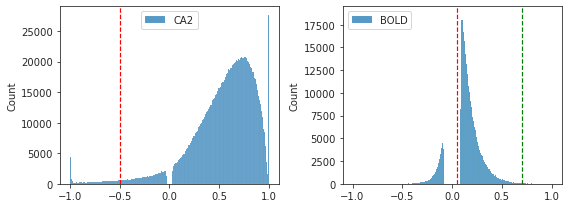

In [5]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(adj_all_ca[adj_all_ca.nonzero()], label='CA2', ax=axes[0])
sns.histplot(adj_all_bo[adj_all_bo.nonzero()], label='BOLD', ax=axes[1])
axes[0].axvline(-0.5, color='r', ls='--', lw=1.2)
axes[1].axvline(0.05, color='r', ls='--', lw=1.2)
axes[1].axvline(0.70, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

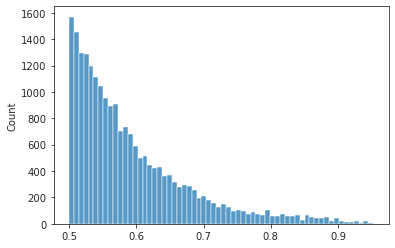

In [6]:
sns.histplot(adj_all_bo[adj_all_bo > 0.5]);

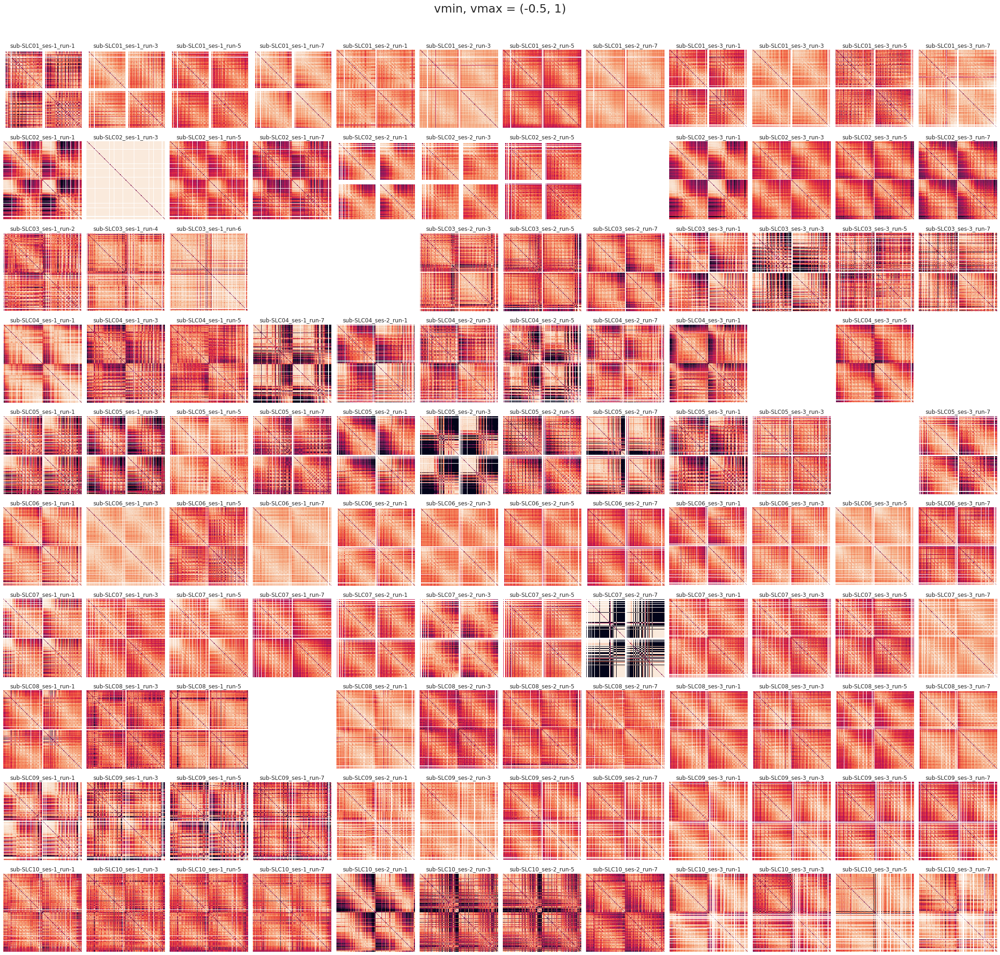

In [7]:
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        x = adj_ca.get(key)
        ax = axes[i, j]
        if x is None:
            ax.remove()
            continue
        ax.set_title(key, fontsize=12)
        ax.imshow(x, vmin=-0.5, vmax=1)
remove_ticks(axes)
sup = fig.suptitle('vmin, vmax = (-0.5, 1)', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'Adj-CA.pdf'), **fig_kws)
plt.show()

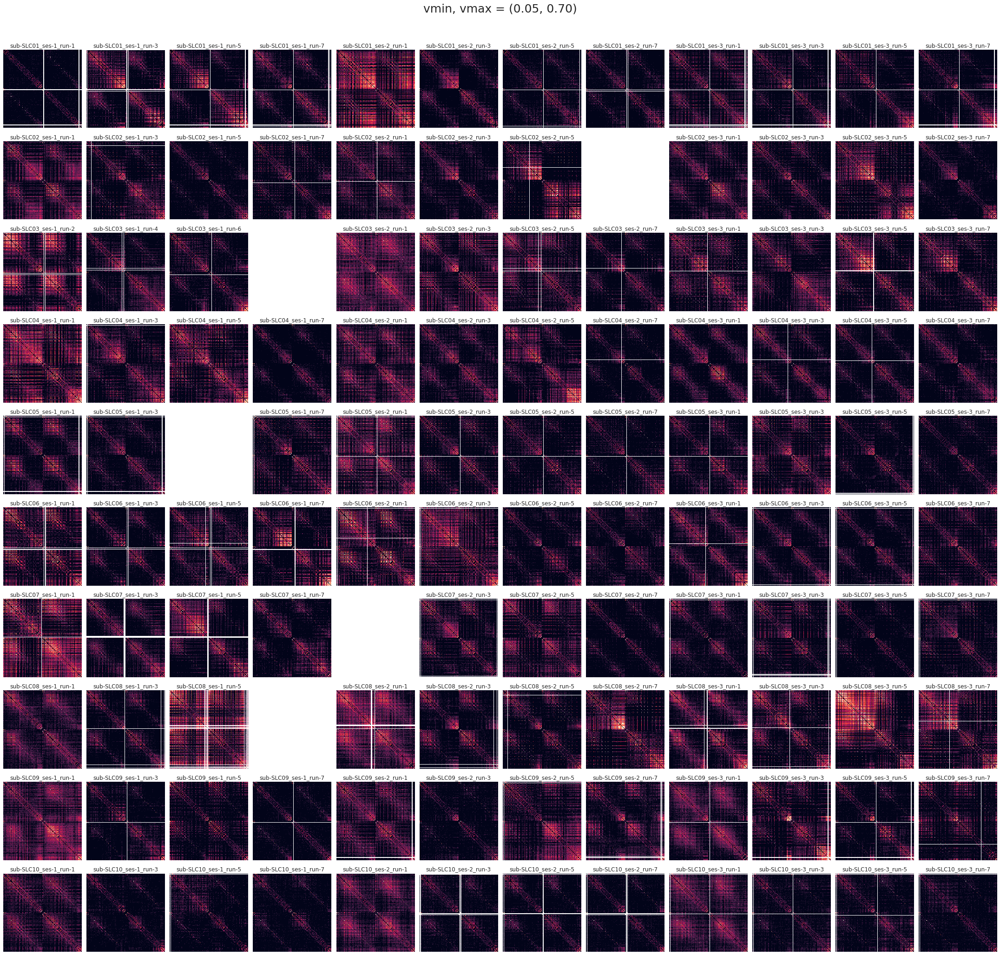

In [8]:
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        x = adj_bo.get(key)
        ax = axes[i, j]
        if x is None:
            ax.remove()
            continue
        ax.set_title(key, fontsize=12)
        ax.imshow(x, vmin=0.05, vmax=0.70)
remove_ticks(axes)
sup = fig.suptitle('vmin, vmax = (0.05, 0.70)', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'Adj-BOLD.pdf'), **fig_kws)
plt.show()

In [9]:
avg_corr_ca = bn.nanmean(adj_all_ca, -1)
avg_corr_bo = bn.nanmean(adj_all_bo, -1)

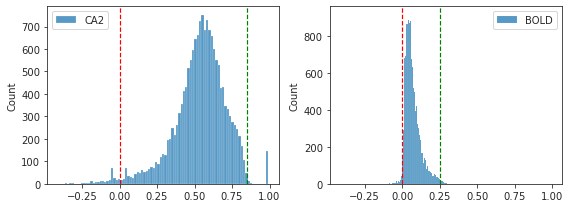

In [40]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(avg_corr_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(avg_corr_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(0, color='r', ls='--', lw=1.2)
axes[0].axvline(0.85, color='g', ls='--', lw=1.2)
axes[1].axvline(0, color='r', ls='--', lw=1.2)
axes[1].axvline(0.25, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

In [10]:
gr = Group(mice, 5, mode='ca2')

In [11]:
tr_ca = gr.project_vec(avg_corr_ca, add_disjoint=False)
tr_bo = gr.project_vec(avg_corr_bo, add_disjoint=False)
tr_ca = gr.trim2d(tr_ca)
tr_bo = gr.trim2d(tr_bo)

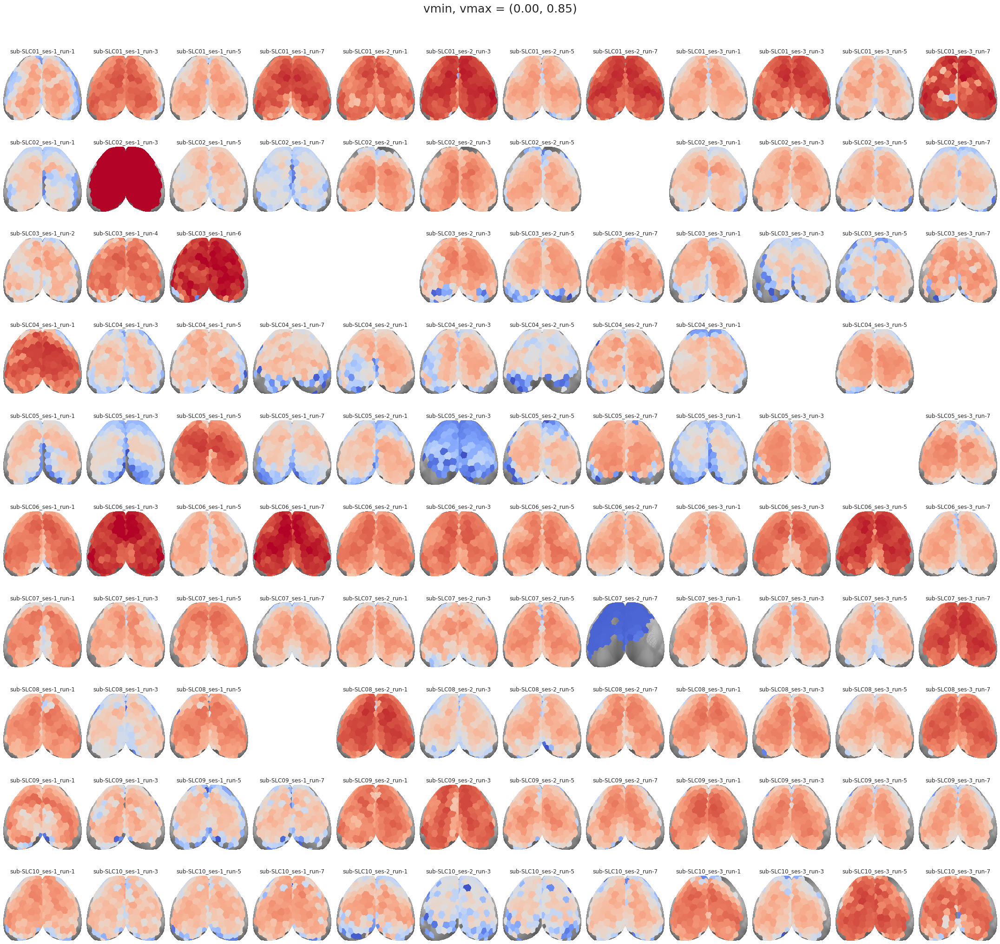

In [57]:
vmin, vmax = 0, 0.85
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        ax = axes[i, j]
        if key not in dirs_ca:
            ax.remove()
            continue
        idx = list(dirs_ca).index(key)
        ax.set_title(f"{key}", fontsize=12)
        ax.imshow(mwh(tr_ca['top'] == 0, tr_ca['top']), cmap='Greys_r')
        ax.imshow(
            mwh(tr_ca['proj-top'][idx] <= vmin, tr_ca['proj-top'][idx]),
            cmap='coolwarm',
            vmin=vmin,
            vmax=vmax,
        )
remove_ticks(axes)
sup = fig.suptitle(f'vmin, vmax = ({vmin:0.2f}, {vmax:0.2f})', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'AvgCorr-CA.png'), dpi=300, bbox_inches='tight')
plt.show()

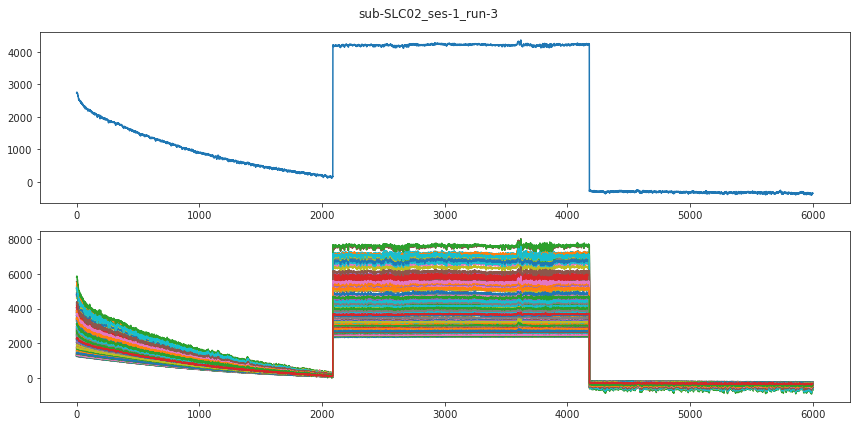

In [99]:
key = 'sub-SLC02_ses-1_run-3'
x = mice.ca[key][:]
gs = bn.nanmean(x, 0)

fig, axes = create_figure(2, 1, (12, 6))
axes[0].plot(gs)
axes[1].plot(x.T)
fig.suptitle(key)
plt.show()

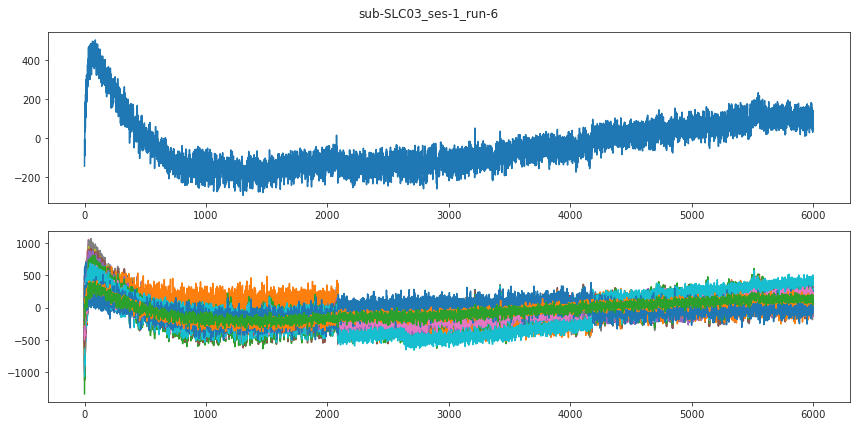

In [100]:
key = 'sub-SLC03_ses-1_run-6'
x = mice.ca[key][:]
gs = bn.nanmean(x, 0)

fig, axes = create_figure(2, 1, (12, 6))
axes[0].plot(gs)
axes[1].plot(x.T)
fig.suptitle(key)
plt.show()

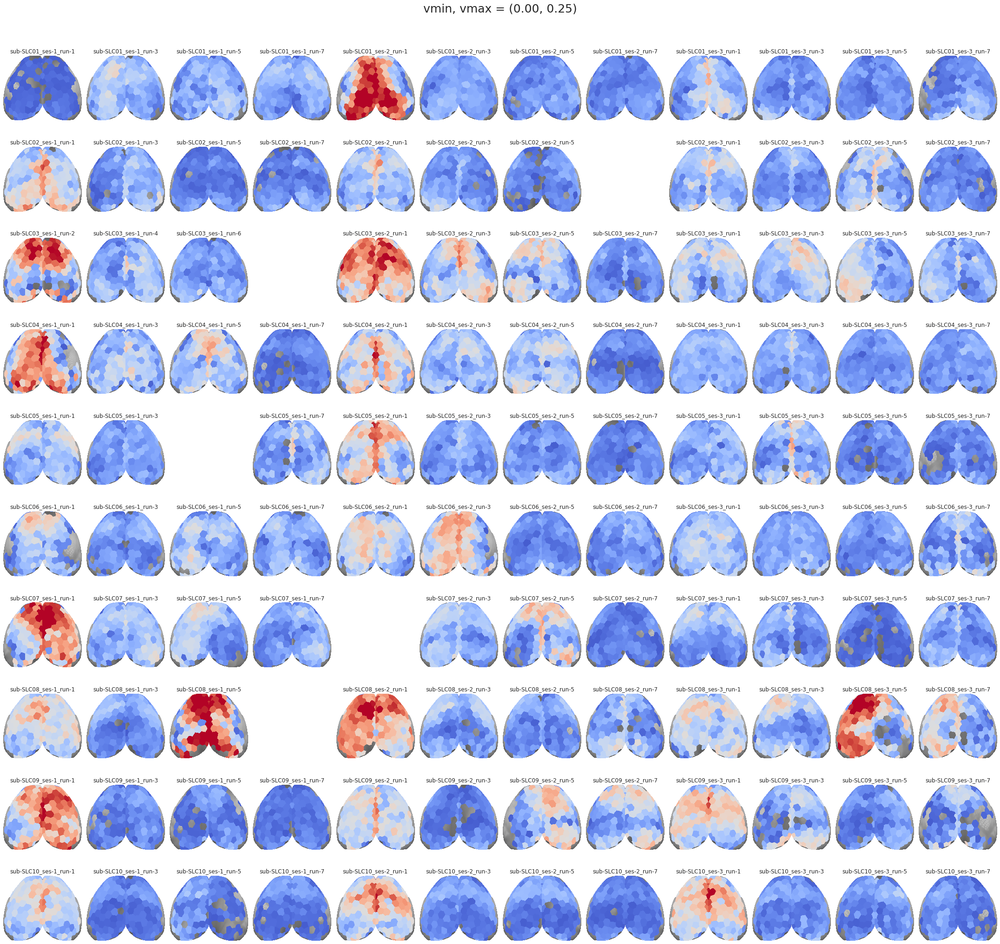

In [59]:
vmin, vmax = 0, 0.25
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        ax = axes[i, j]
        if key not in dirs_bo:
            ax.remove()
            continue
        idx = list(dirs_bo).index(key)
        ax.set_title(f"{key}", fontsize=12)
        ax.imshow(mwh(tr_bo['top'] == 0, tr_bo['top']), cmap='Greys_r')
        ax.imshow(
            mwh(tr_bo['proj-top'][idx] <= vmin, tr_bo['proj-top'][idx]),
            cmap='coolwarm',
            vmin=vmin,
            vmax=vmax,
        )
remove_ticks(axes)
sup = fig.suptitle(f'vmin, vmax = ({vmin:0.2f}, {vmax:0.2f})', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'AvgCorr-BOLD.png'), dpi=300, bbox_inches='tight')
plt.show()

#### Binary

In [60]:
g_ca = collect_graphs(mice, 'ca2', perc=10)
g_bo = collect_graphs(mice, 'bold-lite', perc=10)

adj_ca = {}
adj_all_ca = []
for key, g in g_ca.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_ca[key] = a
    adj_all_ca.append(np.expand_dims(a, 0))
adj_all_ca = np.concatenate(adj_all_ca)

adj_bo = {}
adj_all_bo = []
for key, g in g_bo.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_bo[key] = a
    adj_all_bo.append(np.expand_dims(a, 0))
adj_all_bo = np.concatenate(adj_all_bo)

In [66]:
deg_ca = bn.nansum(adj_all_ca, -1)
deg_bo = bn.nansum(adj_all_bo, -1)

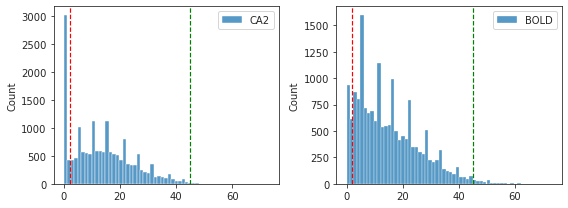

In [72]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(deg_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(deg_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(2, color='r', ls='--', lw=1.2)
axes[0].axvline(45, color='g', ls='--', lw=1.2)
axes[1].axvline(2, color='r', ls='--', lw=1.2)
axes[1].axvline(45, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

In [67]:
%%time

gr = Group(mice, 5, mode='ca2')

tr_ca = gr.project_vec(deg_ca, add_disjoint=False)
tr_bo = gr.project_vec(deg_bo, add_disjoint=False)
tr_ca = gr.trim2d(tr_ca)
tr_bo = gr.trim2d(tr_bo)

CPU times: user 24.4 s, sys: 3min, total: 3min 24s
Wall time: 3min 29s


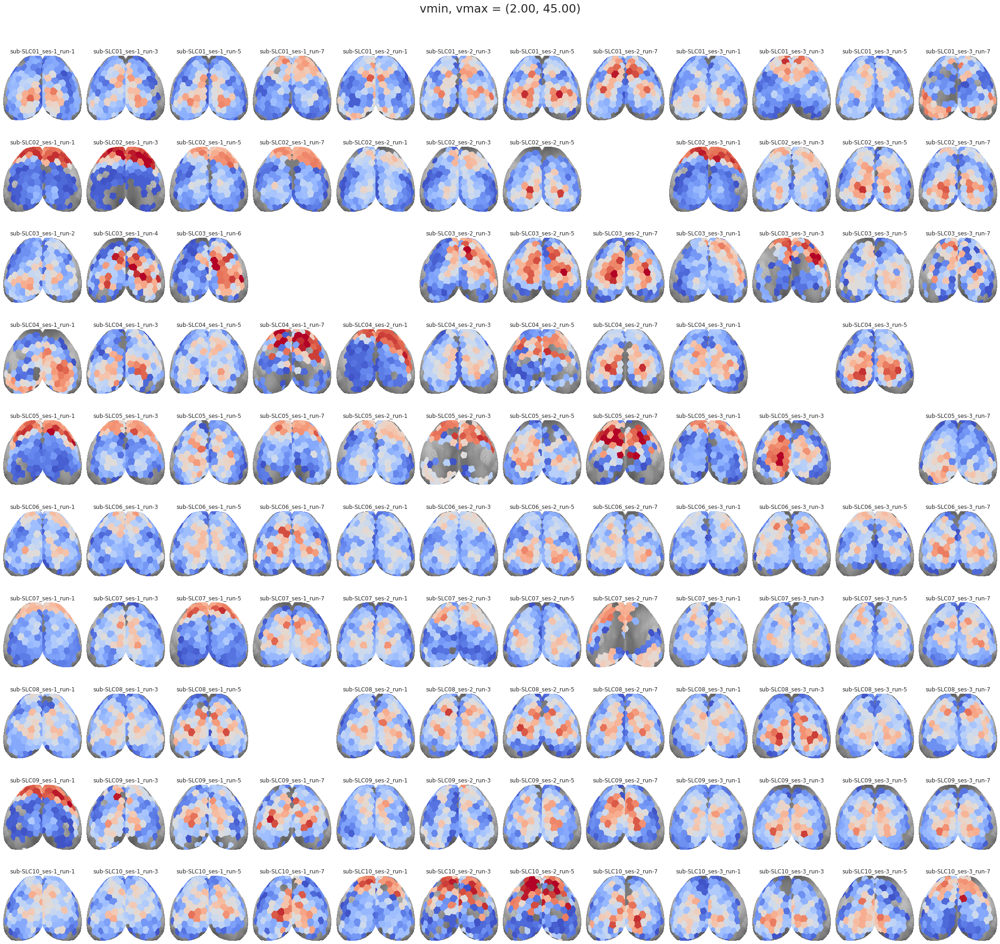

In [73]:
vmin, vmax = 2, 45
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        ax = axes[i, j]
        if key not in dirs_ca:
            ax.remove()
            continue
        idx = list(dirs_ca).index(key)
        ax.set_title(f"{key}", fontsize=12)
        ax.imshow(mwh(tr_ca['top'] == 0, tr_ca['top']), cmap='Greys_r')
        ax.imshow(
            mwh(tr_ca['proj-top'][idx] <= vmin, tr_ca['proj-top'][idx]),
            cmap='coolwarm',
            vmin=vmin,
            vmax=vmax,
        )
remove_ticks(axes)
sup = fig.suptitle(f'vmin, vmax = ({vmin:0.2f}, {vmax:0.2f})', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'AvgDeg-CA.png'), dpi=300, bbox_inches='tight')
plt.show()

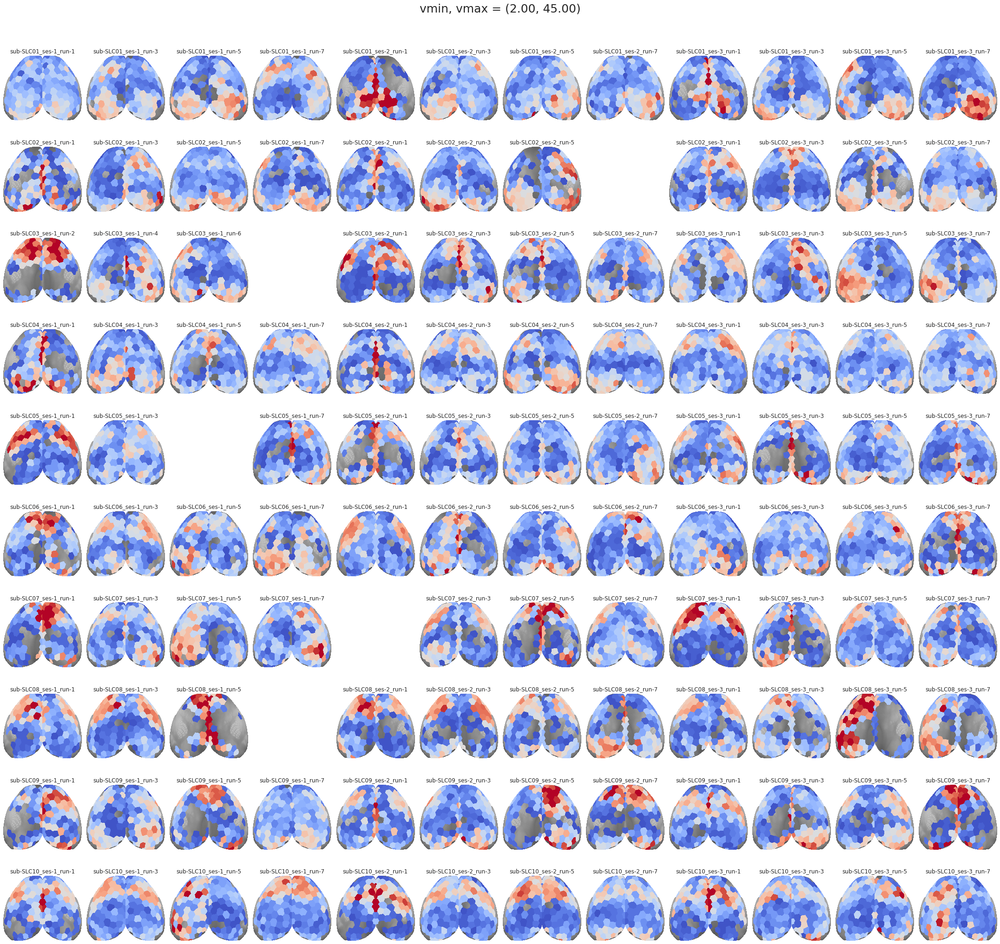

In [74]:
vmin, vmax = 2, 45
nrows, ncols = 10, 12
fig, axes = create_figure(nrows, ncols, (30, 2.8 * nrows), 'all', 'all', tight_layout=True)
for i, sub in enumerate(mice.cfg.sub_ids):
    looper = itertools.product(
        mice.cfg.ses_ids, [1, 3, 5, 7])
    for j, (ses, run) in enumerate(looper):
        if sub == 3 and ses == 1:
            key = mice.get_key(sub, ses, run + 1)
        else:
            key = mice.get_key(sub, ses, run)
        ax = axes[i, j]
        if key not in dirs_bo:
            ax.remove()
            continue
        idx = list(dirs_bo).index(key)
        ax.set_title(f"{key}", fontsize=12)
        ax.imshow(mwh(tr_bo['top'] == 0, tr_bo['top']), cmap='Greys_r')
        ax.imshow(
            mwh(tr_bo['proj-top'][idx] <= vmin, tr_bo['proj-top'][idx]),
            cmap='coolwarm',
            vmin=vmin,
            vmax=vmax,
        )
remove_ticks(axes)
sup = fig.suptitle(f'vmin, vmax = ({vmin:0.2f}, {vmax:0.2f})', fontsize=25, y=1.02)
fig.savefig(pjoin(fig_dir, 'AvgDeg-BOLD.png'), dpi=300, bbox_inches='tight')
plt.show()

#### Group avg

In [82]:
aaa_bo = bn.nanmean(avg_corr_bo, 0)
aaa_ca = bn.nanmean(avg_corr_ca, 0)

bbb_bo = bn.nanmean(deg_bo, 0)
bbb_ca = bn.nanmean(deg_ca, 0)

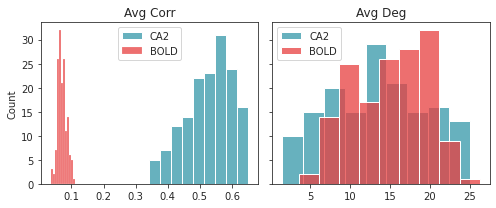

In [97]:
fig, axes = create_figure(1, 2, (7, 3), sharey='all')

sns.histplot(aaa_ca, color=pal['ca2'], ax=axes[0], label='CA2')
sns.histplot(bbb_ca, color=pal['ca2'], ax=axes[1], label='CA2')
sns.histplot(aaa_bo, color=pal['bold-lite'], ax=axes[0], label='BOLD')
sns.histplot(bbb_bo, color=pal['bold-lite'], ax=axes[1], label='BOLD')
axes[0].set_title('Avg Corr')
axes[1].set_title('Avg Deg')

for ax in axes.flat:
    ax.legend()
    
plt.show()

In [106]:
aaa = np.concatenate([np.expand_dims(aaa_ca, 0), np.expand_dims(aaa_bo, 0)])
bbb = np.concatenate([np.expand_dims(bbb_ca, 0), np.expand_dims(bbb_bo, 0)])

tr_aaa = gr.project_vec(aaa, add_disjoint=False)
tr_bbb = gr.project_vec(bbb, add_disjoint=False)
tr_aaa = gr.trim2d(tr_aaa)
tr_bbb = gr.trim2d(tr_bbb)

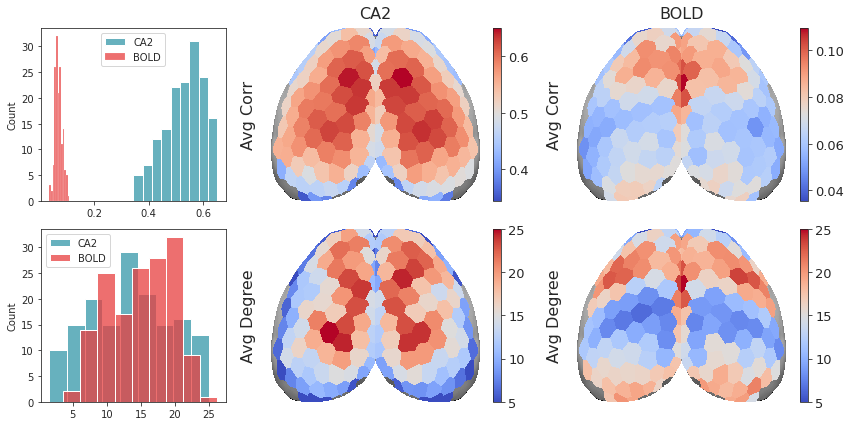

In [164]:
fig, axes = create_figure(2, 3, (12, 6), width_ratios=[0.7, 1, 1])

sns.histplot(aaa[0], label='CA2', color=pal['ca2'], ax=axes[0, 0])
sns.histplot(aaa[1], label='BOLD', color=pal['bold-lite'], ax=axes[0, 0])

sns.histplot(bbb[0], label='CA2', color=pal['ca2'], ax=axes[1, 0])
sns.histplot(bbb[1], label='BOLD', color=pal['bold-lite'], ax=axes[1, 0])

for i in range(2):
    axes[0, i + 1].set_ylabel('Avg Corr', labelpad=15, fontsize=16)
    axes[1, i + 1].set_ylabel('Avg Degree', labelpad=15, fontsize=16)
    axes[i, 0].legend()
    
    ax = axes[0, i + 1]
    ax.imshow(mwh(tr_aaa['top'] == 0, tr_aaa['top']), cmap='Greys_r')
    x2p = mwh(tr_aaa['proj-top'][i] == 0, tr_aaa['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm')
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)
    
    ax = axes[1, i + 1]
    ax.imshow(mwh(tr_bbb['top'] == 0, tr_bbb['top']), cmap='Greys_r')
    x2p = mwh(tr_bbb['proj-top'][i] == 0, tr_bbb['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm', vmin=5, vmax=25)
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)

axes[0, 1].set_title('CA2', y=1.02, fontsize=16)
axes[0, 2].set_title('BOLD', y=1.02, fontsize=16)

plt.show()

### Concise: 128 * 3

In [3]:
mice = Mice((128, 3))
mice.setup_func_data(exclude=True)

In [4]:
adj_all_ca, dirs_ca = collect_adjacencies(mice, 'ca2')
adj_ca = dict(zip(dirs_ca, adj_all_ca))

adj_all_bo, dirs_bo = collect_adjacencies(mice, 'bold-lite')
adj_bo = dict(zip(dirs_bo, adj_all_bo))

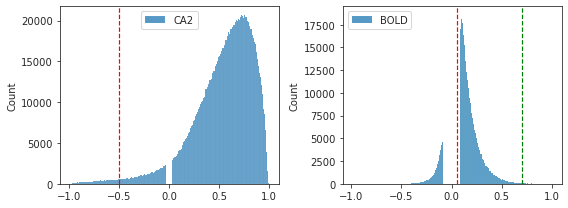

In [5]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(adj_all_ca[adj_all_ca.nonzero()], label='CA2', ax=axes[0])
sns.histplot(adj_all_bo[adj_all_bo.nonzero()], label='BOLD', ax=axes[1])
axes[0].axvline(-0.5, color='r', ls='--', lw=1.2)
axes[1].axvline(0.05, color='r', ls='--', lw=1.2)
axes[1].axvline(0.70, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

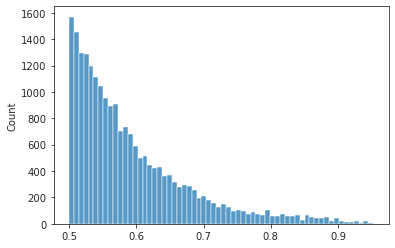

In [6]:
sns.histplot(adj_all_bo[adj_all_bo > 0.5]);

In [7]:
avg_corr_ca = bn.nanmean(adj_all_ca, -1)
avg_corr_bo = bn.nanmean(adj_all_bo, -1)

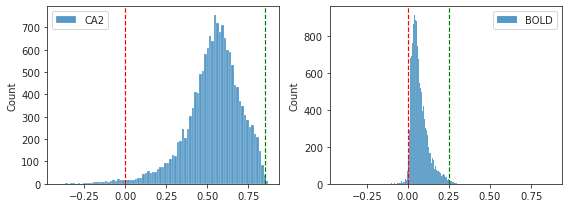

In [8]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(avg_corr_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(avg_corr_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(0, color='r', ls='--', lw=1.2)
axes[0].axvline(0.85, color='g', ls='--', lw=1.2)
axes[1].axvline(0, color='r', ls='--', lw=1.2)
axes[1].axvline(0.25, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

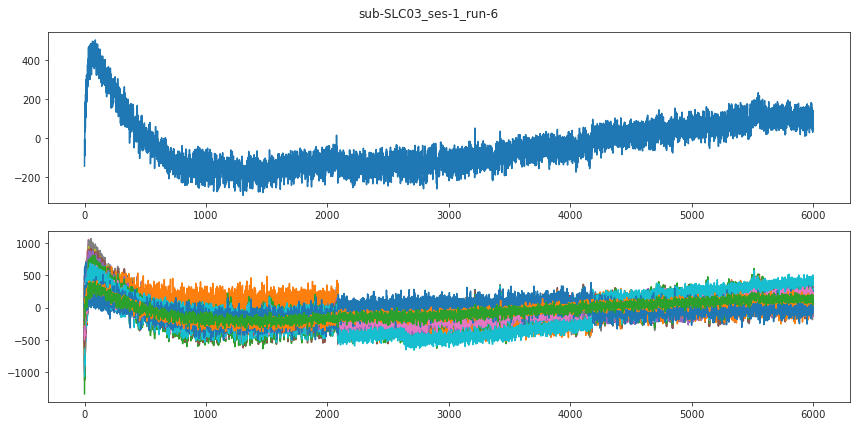

In [9]:
key = 'sub-SLC03_ses-1_run-6'
x = mice.ca[key][:]
gs = bn.nanmean(x, 0)

fig, axes = create_figure(2, 1, (12, 6))
axes[0].plot(gs)
axes[1].plot(x.T)
fig.suptitle(key)
plt.show()

#### Binary

In [10]:
g_ca = collect_graphs(mice, 'ca2', perc=10)
g_bo = collect_graphs(mice, 'bold-lite', perc=10)

adj_ca = {}
adj_all_ca = []
for key, g in g_ca.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_ca[key] = a
    adj_all_ca.append(np.expand_dims(a, 0))
adj_all_ca = np.concatenate(adj_all_ca)

adj_bo = {}
adj_all_bo = []
for key, g in g_bo.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_bo[key] = a
    adj_all_bo.append(np.expand_dims(a, 0))
adj_all_bo = np.concatenate(adj_all_bo)

In [11]:
deg_ca = bn.nansum(adj_all_ca, -1)
deg_bo = bn.nansum(adj_all_bo, -1)

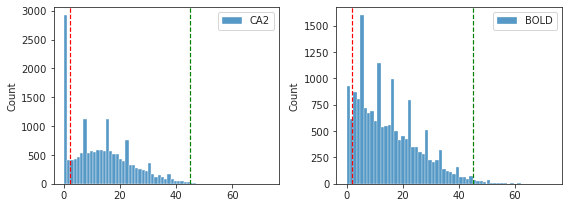

In [12]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(deg_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(deg_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(2, color='r', ls='--', lw=1.2)
axes[0].axvline(45, color='g', ls='--', lw=1.2)
axes[1].axvline(2, color='r', ls='--', lw=1.2)
axes[1].axvline(45, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

#### Group avg

In [13]:
aaa_bo = bn.nanmean(avg_corr_bo, 0)
aaa_ca = bn.nanmean(avg_corr_ca, 0)

bbb_bo = bn.nanmean(deg_bo, 0)
bbb_ca = bn.nanmean(deg_ca, 0)

In [14]:
gr = Group(mice, mode='ca2')

In [15]:
aaa = np.concatenate([np.expand_dims(aaa_ca, 0), np.expand_dims(aaa_bo, 0)])
bbb = np.concatenate([np.expand_dims(bbb_ca, 0), np.expand_dims(bbb_bo, 0)])

tr_aaa = gr.project_vec(aaa, add_disjoint=False)
tr_bbb = gr.project_vec(bbb, add_disjoint=False)
tr_aaa = gr.trim2d(tr_aaa)
tr_bbb = gr.trim2d(tr_bbb)

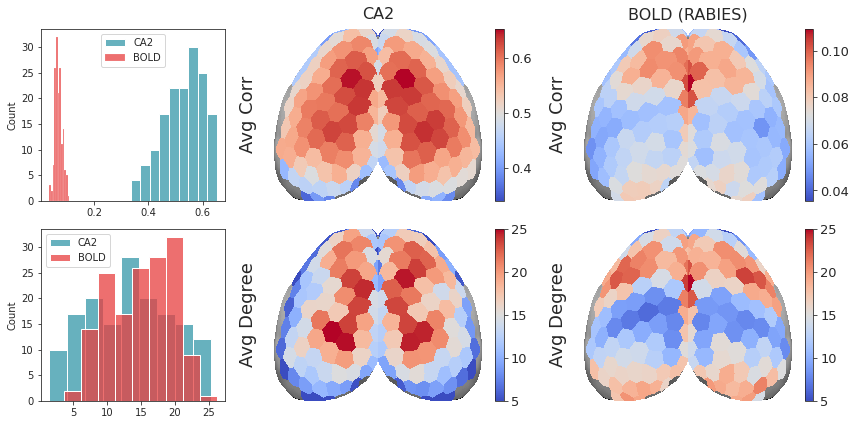

In [19]:
fig, axes = create_figure(2, 3, (12, 6), width_ratios=[0.7, 1, 1])

sns.histplot(aaa[0], label='CA2', color=pal['ca2'], ax=axes[0, 0])
sns.histplot(aaa[1], label='BOLD', color=pal['bold-lite'], ax=axes[0, 0])

sns.histplot(bbb[0], label='CA2', color=pal['ca2'], ax=axes[1, 0])
sns.histplot(bbb[1], label='BOLD', color=pal['bold-lite'], ax=axes[1, 0])

for i in range(2):
    axes[0, i + 1].set_ylabel('Avg Corr', labelpad=17, fontsize=18)
    axes[1, i + 1].set_ylabel('Avg Degree', labelpad=17, fontsize=18)
    axes[i, 0].legend()
    
    ax = axes[0, i + 1]
    ax.imshow(mwh(tr_aaa['top'] == 0, tr_aaa['top']), cmap='Greys_r')
    x2p = mwh(tr_aaa['proj-top'][i] == 0, tr_aaa['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm')
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)
    
    ax = axes[1, i + 1]
    ax.imshow(mwh(tr_bbb['top'] == 0, tr_bbb['top']), cmap='Greys_r')
    x2p = mwh(tr_bbb['proj-top'][i] == 0, tr_bbb['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm', vmin=5, vmax=25)
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)

axes[0, 1].set_title('CA2', y=1.02, fontsize=16)
axes[0, 2].set_title('BOLD (RABIES)', y=1.02, fontsize=16)

fig.savefig(pjoin(fig_dir, 'DegCorrGrp-NEW.pdf'), **fig_kws)

plt.show()

### Concise: 128 * 0

In [20]:
mice = Mice((128, 0))
mice.setup_func_data(exclude=True)

In [21]:
adj_all_ca, dirs_ca = collect_adjacencies(mice, 'ca2')
adj_ca = dict(zip(dirs_ca, adj_all_ca))

adj_all_bo, dirs_bo = collect_adjacencies(mice, 'bold-lite')
adj_bo = dict(zip(dirs_bo, adj_all_bo))

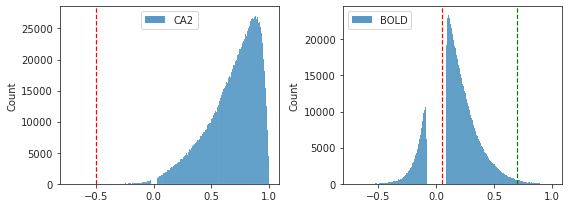

In [22]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(adj_all_ca[adj_all_ca.nonzero()], label='CA2', ax=axes[0])
sns.histplot(adj_all_bo[adj_all_bo.nonzero()], label='BOLD', ax=axes[1])
axes[0].axvline(-0.5, color='r', ls='--', lw=1.2)
axes[1].axvline(0.05, color='r', ls='--', lw=1.2)
axes[1].axvline(0.70, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

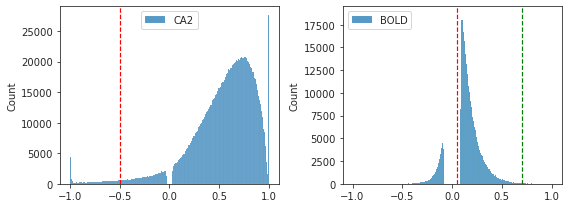

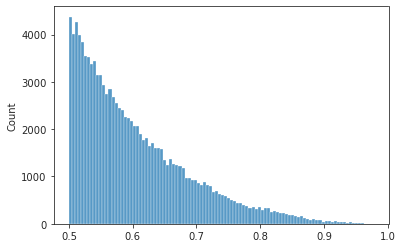

In [23]:
sns.histplot(adj_all_bo[adj_all_bo > 0.5]);

In [24]:
avg_corr_ca = bn.nanmean(adj_all_ca, -1)
avg_corr_bo = bn.nanmean(adj_all_bo, -1)

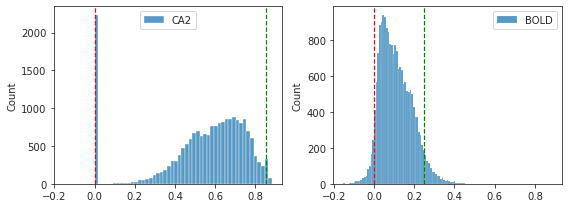

In [25]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(avg_corr_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(avg_corr_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(0, color='r', ls='--', lw=1.2)
axes[0].axvline(0.85, color='g', ls='--', lw=1.2)
axes[1].axvline(0, color='r', ls='--', lw=1.2)
axes[1].axvline(0.25, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

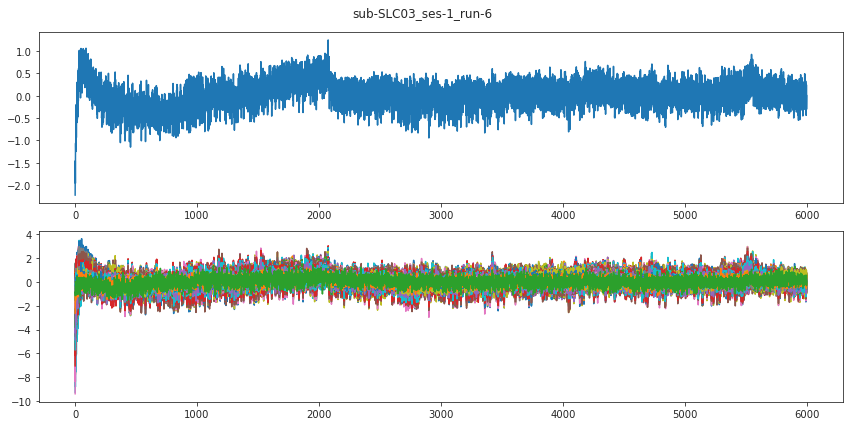

In [26]:
key = 'sub-SLC03_ses-1_run-6'
x = mice.ca[key][:]
gs = bn.nanmean(x, 0)

fig, axes = create_figure(2, 1, (12, 6))
axes[0].plot(gs)
axes[1].plot(x.T)
fig.suptitle(key)
plt.show()

#### Binary

In [27]:
g_ca = collect_graphs(mice, 'ca2', perc=10)
g_bo = collect_graphs(mice, 'bold-lite', perc=10)

adj_ca = {}
adj_all_ca = []
for key, g in g_ca.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_ca[key] = a
    adj_all_ca.append(np.expand_dims(a, 0))
adj_all_ca = np.concatenate(adj_all_ca)

adj_bo = {}
adj_all_bo = []
for key, g in g_bo.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_bo[key] = a
    adj_all_bo.append(np.expand_dims(a, 0))
adj_all_bo = np.concatenate(adj_all_bo)

In [28]:
deg_ca = bn.nansum(adj_all_ca, -1)
deg_bo = bn.nansum(adj_all_bo, -1)

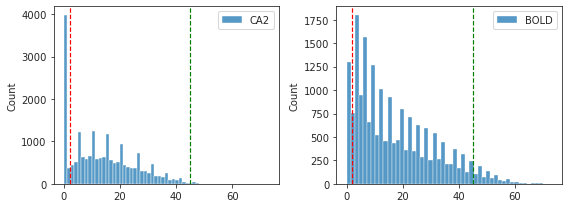

In [29]:
fig, axes = create_figure(1, 2, (8, 3), 'all')
sns.histplot(deg_ca.ravel(), label='CA2', ax=axes[0])
sns.histplot(deg_bo.ravel(), label='BOLD', ax=axes[1])
axes[0].axvline(2, color='r', ls='--', lw=1.2)
axes[0].axvline(45, color='g', ls='--', lw=1.2)
axes[1].axvline(2, color='r', ls='--', lw=1.2)
axes[1].axvline(45, color='g', ls='--', lw=1.2)
for ax in axes.flat:
    ax.legend()
plt.show()

#### Group avg

In [30]:
aaa_bo = bn.nanmean(avg_corr_bo, 0)
aaa_ca = bn.nanmean(avg_corr_ca, 0)

bbb_bo = bn.nanmean(deg_bo, 0)
bbb_ca = bn.nanmean(deg_ca, 0)

In [31]:
gr = Group(mice, mode='ca2')

In [32]:
aaa = np.concatenate([np.expand_dims(aaa_ca, 0), np.expand_dims(aaa_bo, 0)])
bbb = np.concatenate([np.expand_dims(bbb_ca, 0), np.expand_dims(bbb_bo, 0)])

tr_aaa = gr.project_vec(aaa, add_disjoint=False)
tr_bbb = gr.project_vec(bbb, add_disjoint=False)
tr_aaa = gr.trim2d(tr_aaa)
tr_bbb = gr.trim2d(tr_bbb)

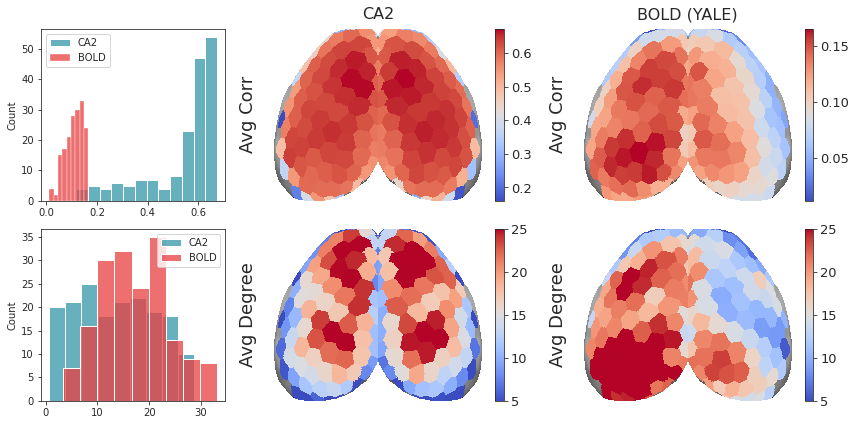

In [33]:
fig, axes = create_figure(2, 3, (12, 6), width_ratios=[0.7, 1, 1])

sns.histplot(aaa[0], label='CA2', color=pal['ca2'], ax=axes[0, 0])
sns.histplot(aaa[1], label='BOLD', color=pal['bold-lite'], ax=axes[0, 0])

sns.histplot(bbb[0], label='CA2', color=pal['ca2'], ax=axes[1, 0])
sns.histplot(bbb[1], label='BOLD', color=pal['bold-lite'], ax=axes[1, 0])

for i in range(2):
    axes[0, i + 1].set_ylabel('Avg Corr', labelpad=17, fontsize=18)
    axes[1, i + 1].set_ylabel('Avg Degree', labelpad=17, fontsize=18)
    axes[i, 0].legend()
    
    ax = axes[0, i + 1]
    ax.imshow(mwh(tr_aaa['top'] == 0, tr_aaa['top']), cmap='Greys_r')
    x2p = mwh(tr_aaa['proj-top'][i] == 0, tr_aaa['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm')
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)
    
    ax = axes[1, i + 1]
    ax.imshow(mwh(tr_bbb['top'] == 0, tr_bbb['top']), cmap='Greys_r')
    x2p = mwh(tr_bbb['proj-top'][i] == 0, tr_bbb['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm', vmin=5, vmax=25)
    cbar = plt.colorbar(im, ax=ax)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)

axes[0, 1].set_title('CA2', y=1.02, fontsize=16)
axes[0, 2].set_title('BOLD (YALE)', y=1.02, fontsize=16)

fig.savefig(pjoin(fig_dir, 'DegCorrGrp-OLD.pdf'), **fig_kws)

plt.show()

### Both 128 * 3 & 128 * 0 in same plot

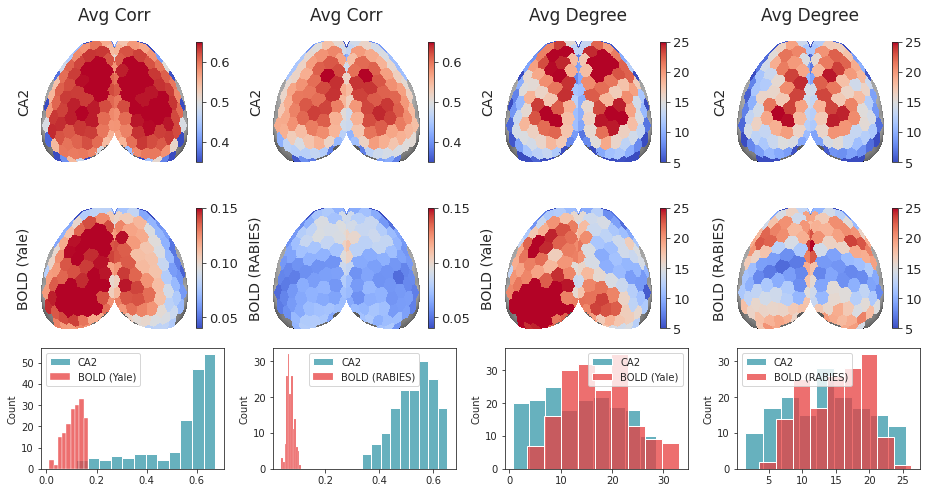

CPU times: user 51.8 s, sys: 1.74 s, total: 53.6 s
Wall time: 53.5 s


In [64]:
%%time

imrng = [(0.35, 0.65), (0.04, 0.15)]
fig, axes = create_figure(3, 4, (13, 7.), height_ratios=[1, 1, 0.7])

for j0, ll in enumerate([0, 3]):
    mice = Mice((128, ll))
    mice.setup_func_data(exclude=True)

    # Weighted
    adj_all_ca, _ = collect_adjacencies(mice, 'ca2')
    adj_all_bo, _ = collect_adjacencies(mice, 'bold-lite')
    avg_corr_ca = bn.nanmean(adj_all_ca, -1)
    avg_corr_bo = bn.nanmean(adj_all_bo, -1)

    # Binary
    g_ca = collect_graphs(mice, 'ca2', perc=10)
    g_bo = collect_graphs(mice, 'bold-lite', perc=10)

    adj_binary_all_ca = []
    for key, g in g_ca.items():
        a = nx.adjacency_matrix(g).toarray()
        a = np.expand_dims(a > 0, 0)
        adj_binary_all_ca.append(a)
    adj_binary_all_ca = np.concatenate(adj_binary_all_ca)

    adj_binary_all_bo = []
    for key, g in g_bo.items():
        a = nx.adjacency_matrix(g).toarray()
        a = np.expand_dims(a > 0, 0)
        adj_binary_all_bo.append(a)
    adj_binary_all_bo = np.concatenate(adj_binary_all_bo)

    deg_ca = bn.nansum(adj_binary_all_ca, -1)
    deg_bo = bn.nansum(adj_binary_all_bo, -1)

    # Group
    aaa_bo = bn.nanmean(avg_corr_bo, 0)
    aaa_ca = bn.nanmean(avg_corr_ca, 0)
    bbb_bo = bn.nanmean(deg_bo, 0)
    bbb_ca = bn.nanmean(deg_ca, 0)

    gr = Group(mice, mode='ca2')
    aaa = np.concatenate([np.expand_dims(aaa_ca, 0), np.expand_dims(aaa_bo, 0)])
    bbb = np.concatenate([np.expand_dims(bbb_ca, 0), np.expand_dims(bbb_bo, 0)])

    tr_aaa = gr.project_vec(aaa, add_disjoint=False)
    tr_bbb = gr.project_vec(bbb, add_disjoint=False)
    tr_aaa = gr.trim2d(tr_aaa)
    tr_bbb = gr.trim2d(tr_bbb)

    # Plot
    j1 = j0
    j2 = j0 + 2
    bold_lbl = 'RABIES' if ll == 3 else 'Yale'
    
    ax = axes[2, j1]
    sns.histplot(aaa[0], label='CA2', color=pal['ca2'], ax=ax)
    sns.histplot(aaa[1], label=f'BOLD ({bold_lbl})', color=pal['bold-lite'], ax=ax)
    ax.legend()

    ax = axes[2, j2]
    sns.histplot(bbb[0], label='CA2', color=pal['ca2'], ax=ax)
    sns.histplot(bbb[1], label=f'BOLD ({bold_lbl})', color=pal['bold-lite'], ax=ax)
    ax.legend()

    for i in range(2):
        ax = axes[i, j1]
        vmin, vmax = imrng[i]
        ax.imshow(mwh(tr_aaa['top'] == 0, tr_aaa['top']), cmap='Greys_r')
        x2p = mwh(tr_aaa['proj-top'][i] == 0, tr_aaa['proj-top'][i])
        im = ax.imshow(x2p, cmap='coolwarm', vmin=vmin, vmax=vmax)
        cbar = plt.colorbar(im, ax=ax, shrink=0.7)
        cbar.ax.tick_params(labelsize=13)
        remove_ticks(ax)

        ax = axes[i, j2]
        ax.imshow(mwh(tr_bbb['top'] == 0, tr_bbb['top']), cmap='Greys_r')
        x2p = mwh(tr_bbb['proj-top'][i] == 0, tr_bbb['proj-top'][i])
        im = ax.imshow(x2p, cmap='coolwarm', vmin=5, vmax=25)
        cbar = plt.colorbar(im, ax=ax, shrink=0.7)
        cbar.ax.tick_params(labelsize=13)
        remove_ticks(ax)

for i in range(2):
    axes[0, i].set_title('Avg Corr', fontsize=17, y=1.12)
    axes[0, i + 2].set_title('Avg Degree', fontsize=17, y=1.12)
for i in range(4):
    axes[0, i].set_ylabel('CA2', labelpad=10, fontsize=14)
for i in [0, 2]:
    axes[1, i].set_ylabel('BOLD (Yale)', labelpad=10, fontsize=14)
for i in [1, 3]:
    axes[1, i].set_ylabel('BOLD (RABIES)', labelpad=10, fontsize=14)

fig.savefig(pjoin(fig_dir, 'DegCorrGrp-Compare.pdf'), **fig_kws)
plt.show()

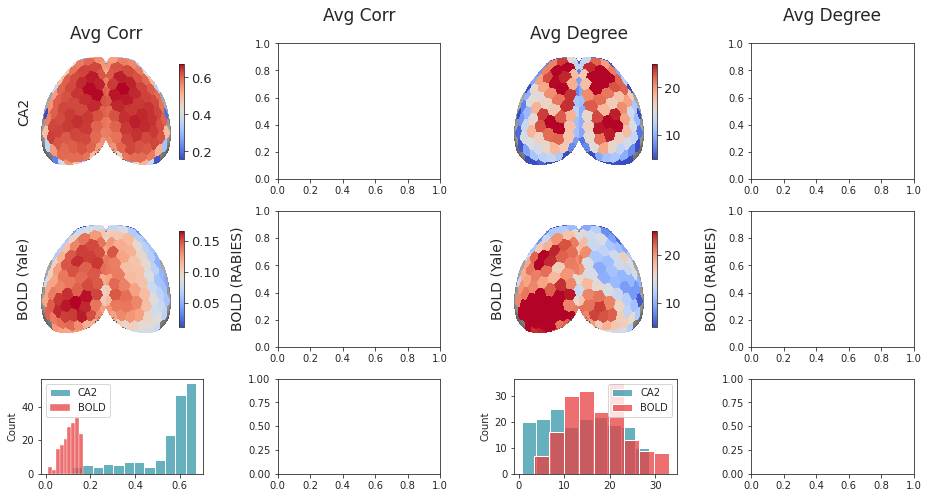

In [61]:
fig, axes = create_figure(3, 4, (13, 7.), height_ratios=[1, 1, 0.7])

j1, j2 = 0, 2

ax = axes[2, j1]
sns.histplot(aaa[0], label='CA2', color=pal['ca2'], ax=ax)
sns.histplot(aaa[1], label='BOLD', color=pal['bold-lite'], ax=ax)
ax.legend()

ax = axes[2, j2]
sns.histplot(bbb[0], label='CA2', color=pal['ca2'], ax=ax)
sns.histplot(bbb[1], label='BOLD', color=pal['bold-lite'], ax=ax)
ax.legend()

for i in range(2):
    ax = axes[i, j1]
    ax.imshow(mwh(tr_aaa['top'] == 0, tr_aaa['top']), cmap='Greys_r')
    x2p = mwh(tr_aaa['proj-top'][i] == 0, tr_aaa['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm')
    cbar = plt.colorbar(im, ax=ax, shrink=0.7)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)

    ax = axes[i, j2]
    ax.imshow(mwh(tr_bbb['top'] == 0, tr_bbb['top']), cmap='Greys_r')
    x2p = mwh(tr_bbb['proj-top'][i] == 0, tr_bbb['proj-top'][i])
    im = ax.imshow(x2p, cmap='coolwarm', vmin=5, vmax=25)
    cbar = plt.colorbar(im, ax=ax, shrink=0.7)
    cbar.ax.tick_params(labelsize=13)
    remove_ticks(ax)
    
for i in range(2):
    axes[0, i].set_title('Avg Corr', fontsize=17, y=1.12)
    axes[0, i + 2].set_title('Avg Degree', fontsize=17, y=1.12)
axes[0, 0].set_ylabel('CA2', labelpad=10, fontsize=14)
for i in [0, 2]:
    axes[1, i].set_ylabel('BOLD (Yale)', labelpad=10, fontsize=14)
for i in [1, 3]:
    axes[1, i].set_ylabel('BOLD (RABIES)', labelpad=10, fontsize=14)

plt.show()

## Plot avg degree: 512

In [2]:
mice = Mice(Config(512))

In [3]:
adj_ca, dirs_ca = collect_adjacencies(mice, 'ca2')
adj_bo, dirs_bo = collect_adjacencies(mice, 'bold-lite')
a_ca = bn.nanmean(adj_ca, 0)
a_bo = bn.nanmean(adj_bo, 0)
a_ca.shape, a_bo.shape

((542, 542), (542, 542))

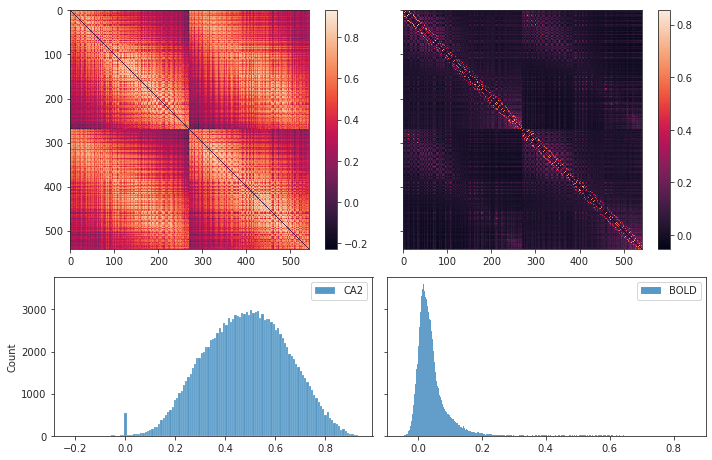

In [4]:
fig, axes = create_figure(2, 2, (10, 6.5), sharey='row', height_ratios=[1.5, 1])
im = axes[0, 0].imshow(a_ca)
plt.colorbar(im, ax=axes[0, 0])
im = axes[0, 1].imshow(a_bo)
plt.colorbar(im, ax=axes[0, 1])

sns.histplot(a_ca[np.tril_indices_from(a_ca)], label='CA2', ax=axes[1, 0])
sns.histplot(a_bo[np.tril_indices_from(a_bo)], label='BOLD', ax=axes[1, 1])
axes[1, 0].legend()
axes[1, 1].legend()

plt.show()

In [5]:
w_ca = dc(a_ca)
w_ca[a_ca < 0] = 0.
w_ca = w_ca.mean(0, keepdims=True)

w_bo = dc(a_bo)
w_bo[a_bo < 0] = 0.
w_bo = w_bo.mean(0, keepdims=True)

w = np.concatenate([w_ca, w_bo])
w.shape

(2, 542)

[<matplotlib.lines.Line2D object at 0x7fd1be790a00>]

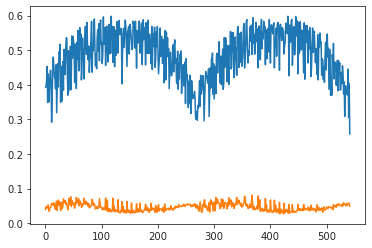

In [6]:
plt.plot(w[0])
plt.plot(w[1])

In [7]:
base = Base(mice, mode='ca2')

In [8]:
proj = base.project_vec(w, add_disjoint=False)
tr = base.trim2d(proj)

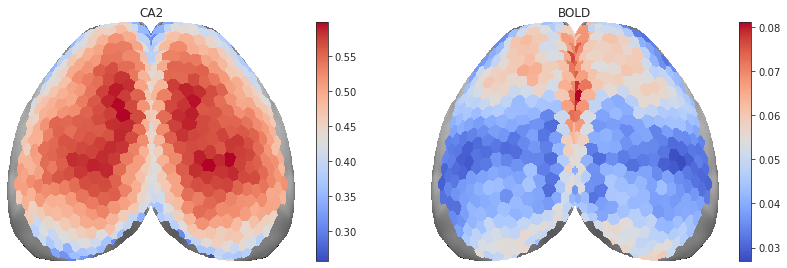

In [9]:
fig, axes = create_figure(1, 2, (12, 3.8))
axes[0].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[0].imshow(mwh(tr['proj-top'][0] == 0, tr['proj-top'][0]), cmap='coolwarm')
plt.colorbar(im, ax=axes[0])
axes[0].set_title('CA2')

axes[1].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[1].imshow(mwh(tr['proj-top'][1] == 0, tr['proj-top'][1]), cmap='coolwarm')
plt.colorbar(im, ax=axes[1])
axes[1].set_title('BOLD')

remove_ticks(axes)
plt.show()

In [10]:
th_ca = calculate_threshold(a_ca, 0.1).item()
th_bo = calculate_threshold(a_bo, 0.1).item()
[np.round(th, 3) for th in [th_ca, th_bo]]

[0.7, 0.101]

In [11]:
ab_ca = dc(a_ca)
ab_ca[a_ca <= th_ca] = 0
ab_ca[a_ca > th_ca] = 1

ab_bo = dc(a_bo)
ab_bo[a_bo <= th_bo] = 0
ab_bo[a_bo > th_bo] = 1

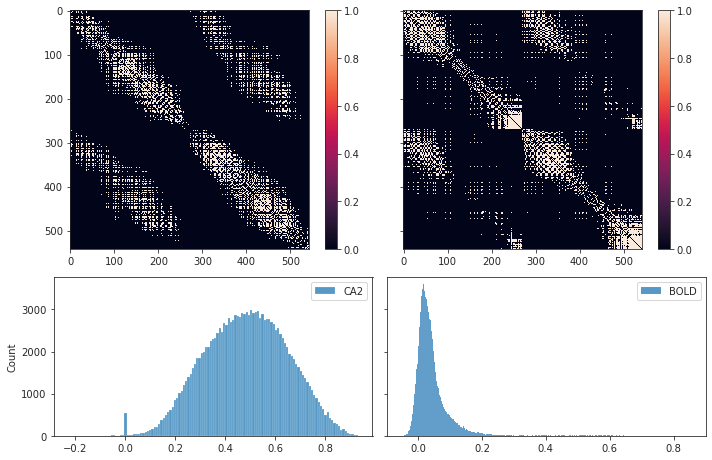

In [12]:
fig, axes = create_figure(2, 2, (10, 6.5), sharey='row', height_ratios=[1.5, 1])
im = axes[0, 0].imshow(ab_ca)
plt.colorbar(im, ax=axes[0, 0])
im = axes[0, 1].imshow(ab_bo)
plt.colorbar(im, ax=axes[0, 1])

sns.histplot(a_ca[np.tril_indices_from(a_ca)], label='CA2', ax=axes[1, 0])
sns.histplot(a_bo[np.tril_indices_from(a_bo)], label='BOLD', ax=axes[1, 1])
axes[1, 0].legend()
axes[1, 1].legend()

plt.show()

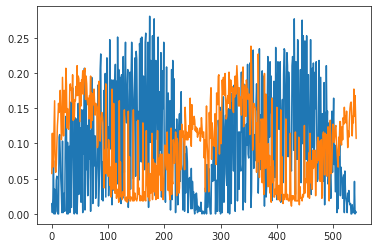

In [13]:
w_ca = ab_ca.mean(0, keepdims=True)
w_bo = ab_bo.mean(0, keepdims=True)
w = np.concatenate([w_ca, w_bo])
plt.plot(w[0])
plt.plot(w[1]);

In [14]:
proj = base.project_vec(w, add_disjoint=False)
tr = base.trim2d(proj)

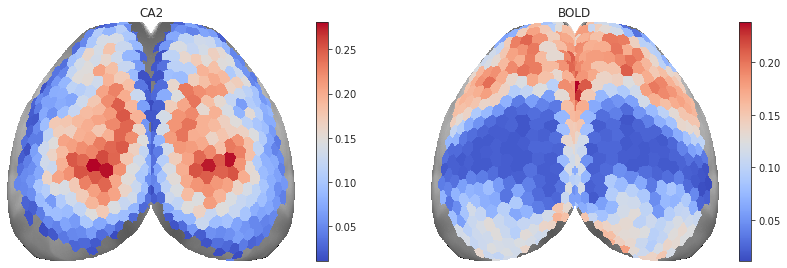

In [15]:
fig, axes = create_figure(1, 2, (12, 3.8))
axes[0].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[0].imshow(mwh(tr['proj-top'][0] == 0, tr['proj-top'][0]), cmap='coolwarm')
plt.colorbar(im, ax=axes[0])
axes[0].set_title('CA2')

axes[1].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[1].imshow(mwh(tr['proj-top'][1] == 0, tr['proj-top'][1]), cmap='coolwarm')
plt.colorbar(im, ax=axes[1])
axes[1].set_title('BOLD')

remove_ticks(axes)
plt.show()

In [23]:
g_ca = collect_graphs(mice, 'ca2', perc=10)
g_bo = collect_graphs(mice, 'bold-lite', perc=10)

In [24]:
adj_ca = []
for key, g in g_ca.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_ca.append(np.expand_dims(a, 0))
adj_ca = np.concatenate(adj_ca)
a_ca = bn.nanmean(adj_ca, 0)

adj_bo = []
for key, g in g_bo.items():
    a = nx.adjacency_matrix(g).toarray()
    a = a > 0
    adj_bo.append(np.expand_dims(a, 0))
adj_bo = np.concatenate(adj_bo)
a_bo = bn.nanmean(adj_bo, 0)

a_ca.shape, a_bo.shape

((542, 542), (542, 542))

[<matplotlib.lines.Line2D object at 0x7fd1bece8ac0>]

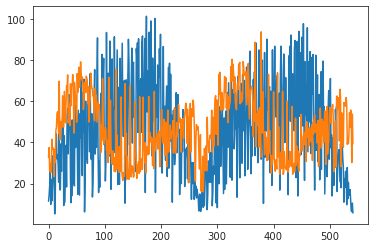

In [26]:
w_ca = a_ca.sum(0, keepdims=True)
w_bo = a_bo.sum(0, keepdims=True)
w = np.concatenate([w_ca, w_bo])

plt.plot(w[0])
plt.plot(w[1])

In [27]:
proj = base.project_vec(w, add_disjoint=False)
tr = base.trim2d(proj)

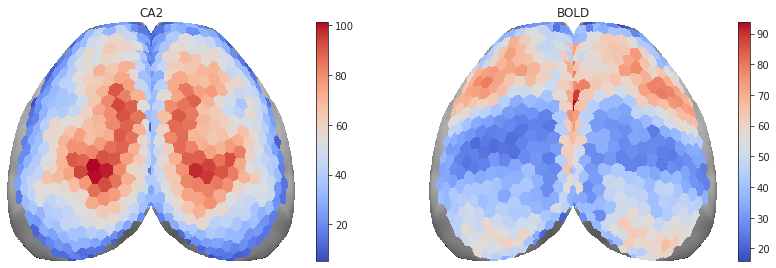

In [28]:
fig, axes = create_figure(1, 2, (12, 3.8))
axes[0].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[0].imshow(mwh(tr['proj-top'][0] == 0, tr['proj-top'][0]), cmap='coolwarm')
plt.colorbar(im, ax=axes[0])
axes[0].set_title('CA2')

axes[1].imshow(mwh(tr['top'] == 0, tr['top']), cmap='Greys_r')
im = axes[1].imshow(mwh(tr['proj-top'][1] == 0, tr['proj-top'][1]), cmap='coolwarm')
plt.colorbar(im, ax=axes[1])
axes[1].set_title('BOLD')

remove_ticks(axes)
plt.show()

In [29]:
x = mice.bold['sub-SLC02_ses-3_run-7'][:]
x.shape

(3072, 520)

[<matplotlib.lines.Line2D object at 0x7fd19b40c850>]

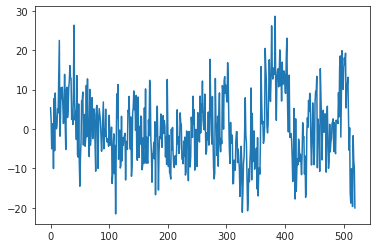

In [30]:
plt.plot(bn.nanmean(x, 0))

### OLD (debug, base, exclude time points etc)

[<matplotlib.lines.Line2D object at 0x7f64087b0a60>]

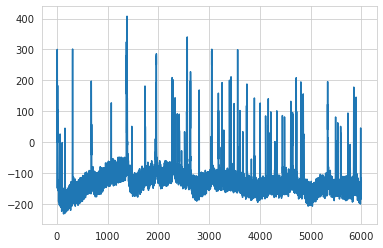

In [3]:
plt.plot(bn.nanmean(mice.ca['sub-SLC01_ses-1_run-1'][:], 0))

[<matplotlib.lines.Line2D object at 0x7f640870bb50>]

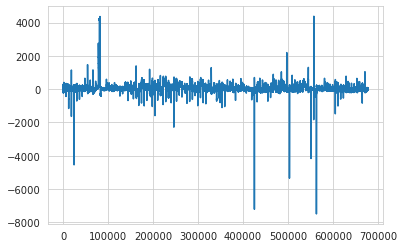

In [4]:
plt.plot(bn.nanmean(mice.ca['sub-SLC'][:], 0))

In [5]:
key = 'sub-SLC09_ses-2_run-1'
base = Base(mice, key=key, mode='ca2', prep_data=True)
base.data.shape

(154, 4999)

In [6]:
good_nodes = np.where(np.isnan(base.data).sum(1) == 0)[0]
len(good_nodes)

140

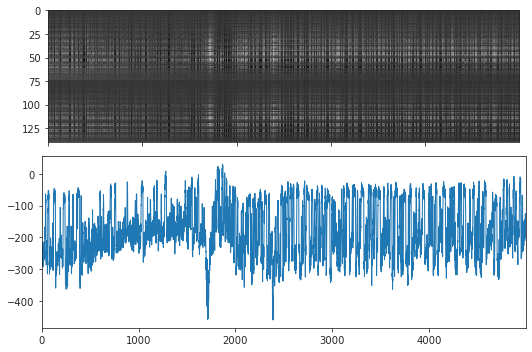

In [7]:
fig, axes = create_figure(2, 1, (7.5, 5), 'col', height_ratios=[1, 1.3])
axes[0].imshow(base.data[good_nodes], cmap='gray_r', aspect=10)
axes[1].plot(base.data[good_nodes].mean(0), lw=1.0)
# for ax in axes.flat:
    # ax.axvline(500, color='gold', ls='-', lw=1.2)
    # ax.axvline(1000, color='tomato', ls='-', lw=1.2)
plt.show()

<matplotlib.lines.Line2D object at 0x7f65c1573c40>

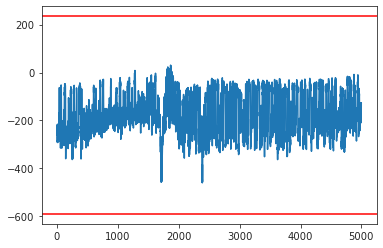

In [8]:
nb_std = 5
gs = bn.nanmean(base.data, 0)
mu = gs.mean()
sd = gs.std()
plt.plot(gs)
plt.axhline(mu + sd * nb_std, color='r')
plt.axhline(mu - sd * nb_std, color='r')

<matplotlib.lines.Line2D object at 0x7f6916216700>

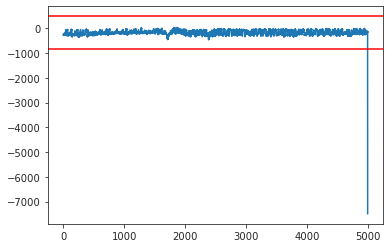

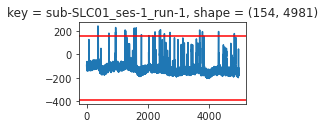

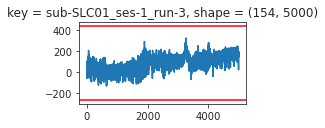

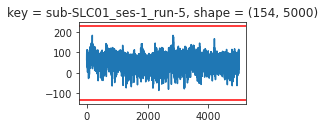

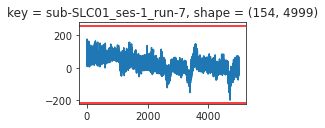

...

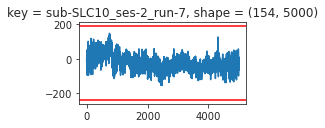

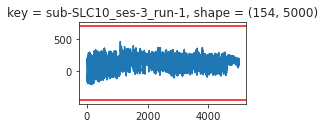

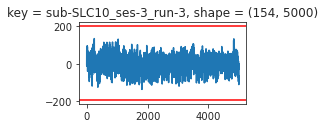

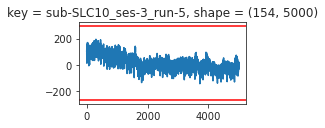

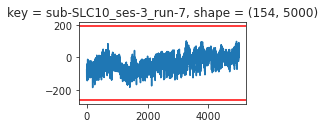

In [9]:
nb_std = 5

nums = {}
for key, func in mice.ca.items():
    if 'run' not in key:
        continue
    base = Base(mice, key=key, mode='ca2', prep_data=True)

    gs = bn.nanmean(base.data, 0)
    mu = gs.mean()
    sd = gs.std()
    plt.figure(figsize=(3, 1.5))
    plt.plot(gs)
    plt.axhline(mu + sd * nb_std, color='r')
    plt.axhline(mu - sd * nb_std, color='r')
    plt.title(f"key = {key}, shape = {base.data.shape}")
    plt.show()
    
    nums[key] = base.data.shape[-1]

In [10]:
collections.Counter(nums.values()).most_common()

[(5000, 100), (4999, 8), (4998, 2), (4997, 2), (4981, 1)]

[
    (5000, 92),
    (4999, 12),
    (4998, 2),
    (4961, 1),
    (4991, 1),
    (4995, 1),
    (4992, 1),
    (4994, 1),
    (4996, 1),
    (4988, 1)
]

In [11]:
{k: v for k, v in nums.items() if v < 5000}

{
    'sub-SLC01_ses-1_run-1': 4981,
    'sub-SLC01_ses-1_run-7': 4999,
    'sub-SLC02_ses-2_run-5': 4998,
    'sub-SLC02_ses-3_run-7': 4998,
    'sub-SLC06_ses-1_run-5': 4997,
    'sub-SLC07_ses-2_run-1': 4999,
    'sub-SLC07_ses-2_run-5': 4999,
    'sub-SLC07_ses-3_run-3': 4999,
    'sub-SLC08_ses-2_run-5': 4999,
    'sub-SLC08_ses-3_run-3': 4997,
    'sub-SLC09_ses-1_run-5': 4999,
    'sub-SLC09_ses-2_run-1': 4999,
    'sub-SLC09_ses-2_run-5': 4999
}

In [12]:
x = mice.ca['sub-SLC08_ses-3_run-3'][:]
x = x[:, 1000:]
x.shape

(154, 5000)

In [13]:
nb_std = 6

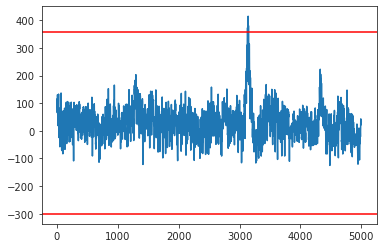

In [14]:
gs = bn.nanmean(x, 0)
mu = gs.mean()
sd = gs.std()
plt.plot(gs)
plt.axhline(mu + sd * nb_std, color='r')
plt.axhline(mu - sd * nb_std, color='r')
plt.show()

[<matplotlib.lines.Line2D object at 0x7f0298a37790>]

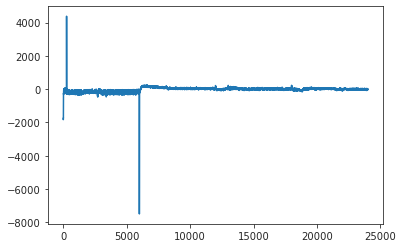

In [15]:
a, _ = get_adj_mat(base.data[good_nodes][:, 1000:], 'pearson')
b, _ = get_adj_mat(base.data[good_nodes][:, 500:], 'pearson')
c, _ = get_adj_mat(base.data[good_nodes][:, 0:], 'pearson')

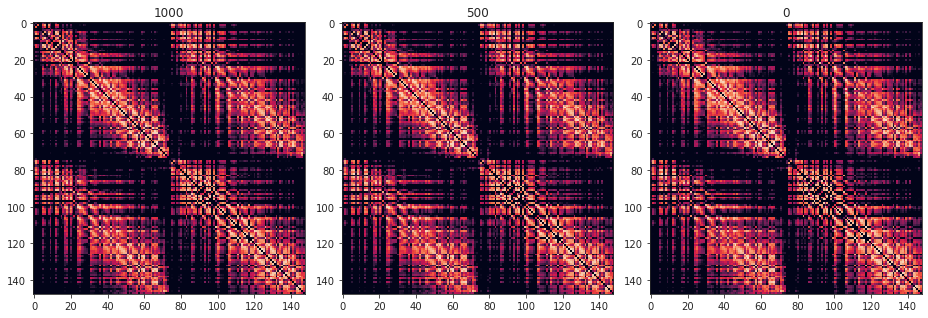

In [61]:
fig, axes = create_figure(1, 3, (13, 4.5))
axes[0].imshow(a, vmin=0.7, vmax=1.0)
axes[1].imshow(b, vmin=0.7, vmax=1.0)
axes[2].imshow(c, vmin=0.7, vmax=1.0)
axes[0].set_title(1000)
axes[1].set_title(500)
axes[2].set_title(0)
plt.show()

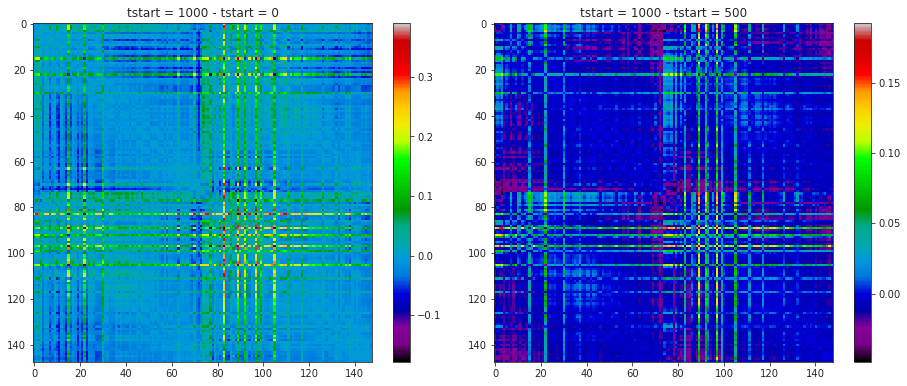

In [62]:
fig, axes = create_figure(1, 2, (13, 5.2))
im = axes[0].imshow(a - c, cmap='nipy_spectral')
plt.colorbar(im, ax=axes[0])
axes[0].set_title(f"tstart = {1000} - tstart = {0}")

im = axes[1].imshow(a - b, cmap='nipy_spectral')
plt.colorbar(im, ax=axes[1])
axes[1].set_title(f"tstart = {1000} - tstart = {500}")
plt.show()

In [63]:
th_a = calculate_threshold(a, 0.1).item()
th_b = calculate_threshold(b, 0.1).item()
th_c = calculate_threshold(c, 0.1).item()
[np.round(th, 3) for th in [th_a, th_b, th_c]]

[0.905, 0.906, 0.908]

In [64]:
ab = dc(a)
ab[a <= th_a] = 0
ab[a > th_a] = 1

bb = dc(b)
bb[b <= th_b] = 0
bb[b > th_b] = 1

cb = dc(c)
cb[b <= th_c] = 0
cb[b > th_c] = 1

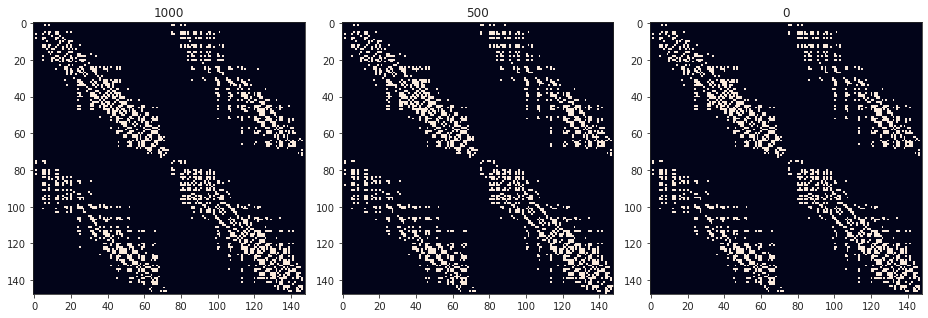

In [65]:
fig, axes = create_figure(1, 3, (13, 4.5))
axes[0].imshow(ab, vmin=0.7, vmax=1.0)
axes[1].imshow(bb, vmin=0.7, vmax=1.0)
axes[2].imshow(cb, vmin=0.7, vmax=1.0)
axes[0].set_title(1000)
axes[1].set_title(500)
axes[2].set_title(0)
plt.show()

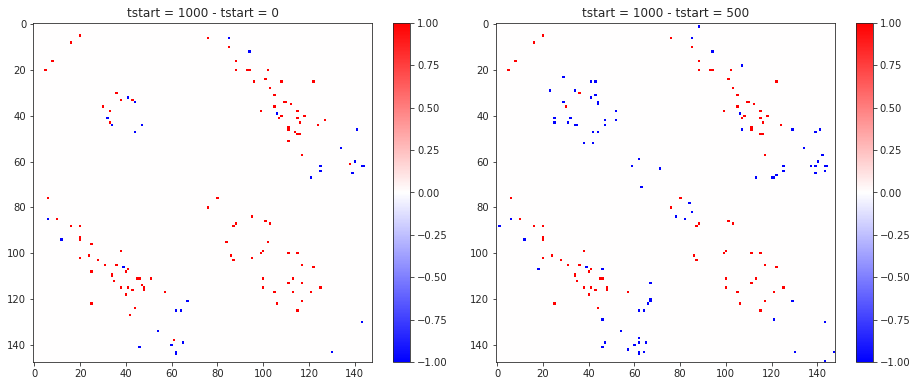

In [66]:
fig, axes = create_figure(1, 2, (13, 5.2))
im = axes[0].imshow(ab - cb, cmap='bwr')
plt.colorbar(im, ax=axes[0])
axes[0].set_title(f"tstart = {1000} - tstart = {0}")

im = axes[1].imshow(ab - bb, cmap='bwr')
plt.colorbar(im, ax=axes[1])
axes[1].set_title(f"tstart = {1000} - tstart = {500}")
plt.show()

In [67]:
sp_dist.hamming(ab.ravel(), bb.ravel()), sp_dist.hamming(ab.ravel(), cb.ravel()), sp_dist.hamming(bb.ravel(), cb.ravel())

(0.007852447041636231, 0.006391526661796932, 0.0034696859021183346)